In [1]:
from pixell import enmap,enplot,utils, reproject
import numpy as np
from astropy.io import fits
import sys
import os
import matplotlib.pyplot as plt
def eshow(x,**kwargs): enplot.show(enplot.plot(x,**kwargs))
from astropy.io import fits
import astropy.coordinates as coord
import astropy.units as u
import sep
import healpy as hp
from astropy.cosmology import z_at_value
from astropy.cosmology import Planck15 as cosmo
%matplotlib inline

(1820, 6825) float64


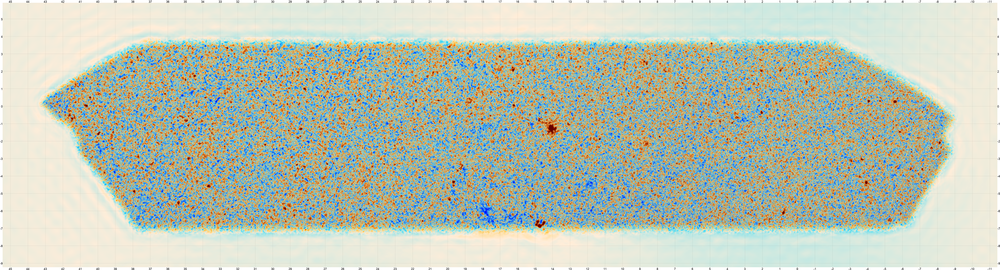

In [3]:
ymap_file = '/mnt/scratch-lustre/mlokken/data/act_ymaps/tilec_single_tile_deep56_comptony_map_v1.2.0_joint.fits'
imap = enmap.read_map(ymap_file,)

ymap = enmap.read_map(ymap_file)
print(ymap.shape, ymap.dtype)
eshow(ymap)
# Write code to get stack

(1820, 6825) float32


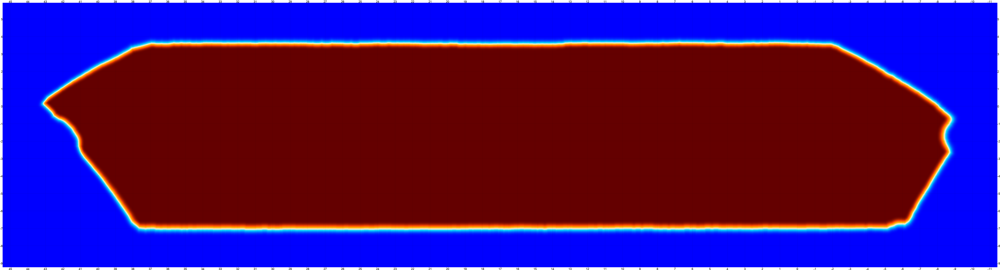

In [4]:
mask_file = '/mnt/scratch-lustre/mlokken/data/act_ymaps/tilec_mask.fits'
mask = enmap.read_map(mask_file)
print(mask.shape, mask.dtype)
eshow(mask)

In [10]:
beam_file = '/mnt/scratch-lustre/mlokken/data/act_ymaps/tilec_single_tile_deep56_comptony_map_v1.2.0_joint_beam.txt'
beam      = np.loadtxt(beam_file)
# remove ell < 20
beam[0:20,1] = 0.

# Import Peak Patch tSZ Map

In [14]:
websky_tsz = hp.read_map('/mnt/scratch-lustre/mlokken/pkpatch/downloaded_sep_25/tsz.fits')
nside      = hp.get_nside(websky_tsz)
hp.mollview(websky_tsz, max=1e-5)

NSIDE = 4096
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


In [15]:
lmax       = 3 * nside
websky_alm = hp.map2alm(pkpatch_tsz, lmax=lmax)
websky_alm_conv = hp.almxfl(np.complex128(websky_alm),beam[:,1])
# ells = np.arange(0,lmax,1)
# fl = ells*0 + 1
# fl[ells<80] = 0
# alm_new = hp.almxfl(pkpatch_alm,fl)

Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


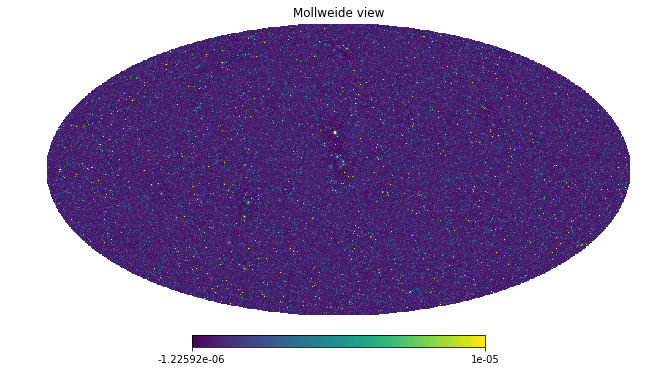

In [18]:
websky_tsz_withbeam = hp.alm2map(websky_alm_conv, nside=nside)
hp.write_map("/mnt/scratch-lustre/mlokken/pkpatch/downloaded_sep_25/tsz_act_beam_conv.fits", websky_tsz_withbeam, overwrite=True)
hp.mollview(websky_tsz_withbeam, max=1e-5)

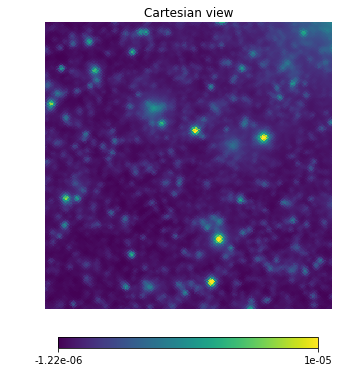

In [26]:
hp.cartview(websky_tsz_withbeam, lonra = [-1,1], latra=[-1,1], max=1e-5)

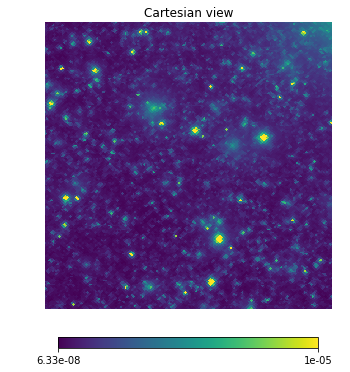

In [27]:
hp.cartview(websky_tsz, lonra = [-1,1], latra=[-1,1], max=1e-5)

In [7]:
# beam_arcmin = 2.
# beam_rad = beam_arcmin / 60. * (np.pi/180.) # convert to radians                
# pkp_ymap_smooth = hp.smoothing(pkpatch_tsz, fwhm = beam_rad, pol=False)

# hp.write_map("/mnt/scratch-lustre/mlokken/pkpatch/downloaded_sep_25/pkpatch_tsz_l80_highpass_smooth_2am.fits", pkp_ymap_smooth)

Sigma is 0.849322 arcmin (0.000247 rad) 
-> fwhm is 2.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


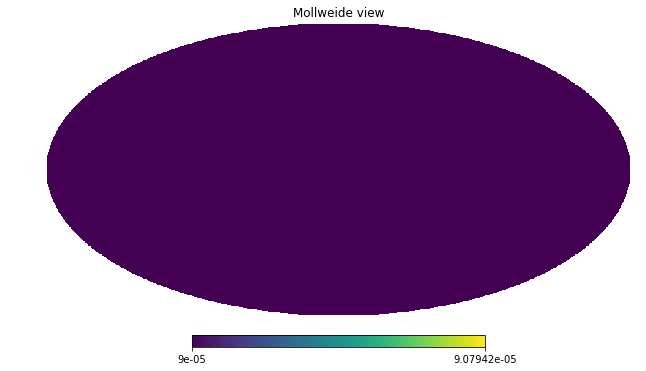

In [18]:
hp.mollview(pkp_ymap_smooth, min=9e-5)

In [6]:
pkp_ymap_smooth = hp.read_map("/mnt/scratch-lustre/mlokken/pkpatch/pkpatch_tsz_l80_highpass_smooth_2am.fits")

NSIDE = 4096
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


## Import Halo Data

In [7]:
halo_catalog = '/mnt/scratch-lustre/mlokken/pkpatch/halos_lgt_ACT_region.npy'

peakdata = np.load(halo_catalog)
M      = peakdata[:,0]
xpos   = peakdata[:,1] * u.Mpc
ypos   = peakdata[:,2] * u.Mpc
zpos   = peakdata[:,3] * u.Mpc
ra     = peakdata[:,4]
dec    = peakdata[:,5]
z      = peakdata[:,6]
print("done")

done


## Cut by redshift

In [8]:
zbins_list = [[0.10003306647845904, 0.33849232502270954], [0.33849232502270954, 0.6151092973371133], [0.6151092973371133, 0.9473303500676481]]
# Choose bin here (low=0, med=1, high=2)
zbin = zbins_list[2]
zbin =  [0.5259945395316767,
  0.5564976206512411]

print("Chosen bin: ", zbin)
zcut = np.where((z > zbin[0]) & (z < zbin[1]))
peakdata_cut1 = peakdata[zcut]

print("Cut from %d to %d" %(len(peakdata),len(peakdata_cut1)))

M      = peakdata_cut1[:,0]
xpos   = peakdata_cut1[:,1] * u.Mpc
ypos   = peakdata_cut1[:,2] * u.Mpc
zpos   = peakdata_cut1[:,3] * u.Mpc
ra     = peakdata_cut1[:,4]
dec    = peakdata_cut1[:,5]
z      = peakdata_cut1[:,6]

Chosen bin:  [0.5259945395316767, 0.5564976206512411]
Cut from 14928636 to 116709


## Cut by halo mass

In [9]:
min_richness = 20 #choose this
max_richness = 1000
lambda_0 = 40
z_0 = 0.35
F_lambda = 1.356
G_z = -0.3
M_0 =  3.081 * 10**14 # in units of M_sun

highz = zbin[1]
lowz = zbin[0]

min_mass = M_0*(min_richness/lambda_0)**F_lambda*((1+highz)/(1+z_0))**G_z
max_mass = M_0*(max_richness/lambda_0)**F_lambda*((1+lowz)/(1+z_0))**G_z
print(min_mass, max_mass)
mass_cut = np.where((M>min_mass)&(M<max_mass))[0]
peakdata_cut2 = peakdata_cut1[mass_cut]

M      = peakdata_cut2[:,0]
xpos   = peakdata_cut2[:,1] * u.Mpc
ypos   = peakdata_cut2[:,2] * u.Mpc
zpos   = peakdata_cut2[:,3] * u.Mpc
ra     = peakdata_cut2[:,4]
dec    = peakdata_cut2[:,5]
z      = peakdata_cut2[:,6]
print("Cut from %d to %d" %(len(peakdata_cut1),len(peakdata_cut2)))

115332210619000.92 2.3352457305639548e+16
Cut from 116709 to 525


Now find clusters within similar region of ACT map

In [10]:
coopwidth = 2. #degrees
pixheight,pixwidth=enmap.pixshape(imap.shape,imap.wcs) #radians
# 0.5 arcminute pixels
# How many pixels will make up 1/2 of each stamp in the ACT map format?
width = int(np.deg2rad(coopwidth)//pixwidth)

In [11]:
map_bounds = enmap.box(ymap.shape,ymap.wcs)/utils.degree
decmin = map_bounds[0,0]
decmax = map_bounds[1,0]
ramin = map_bounds[1,1]+360
ramax = map_bounds[0,1]
print("Dec range: %f, %f\nRA range: %f, %f" %(decmin,decmax,ramin,ramax))

Dec range: -11.037500, 7.145833
RA range: 336.070833, 54.862500


In [12]:
#crop clusters outside of range
padra = 0.
paddec = 0.
include = (dec > decmin+paddec) & (dec < decmax-paddec) & np.logical_or(ra > (ramin),ra < (ramax))
ras_in  = ra[include]
decs_in = dec[include]
mass_in = M[include]
Ncl = len(ras_in)
print(Ncl)

525


In [13]:
masses_of_stacked_cls = []
final_ras = []
final_decs = []

def DeclRatoThetaPhi(decl,RA):
    return np.radians(-decl+90.),np.radians(RA)

Ncl = ras_in.size #decs.size
Ncl_in = 0
thetaphi = []
stamp_sum = np.zeros((width*2+1, width*2+1))
stamp_sum_smooth = np.zeros((width*2+1, width*2+1))
for i in range(Ncl):
    coords = np.deg2rad(np.array((decs_in[i],ras_in[i])))
    ypix, xpix = enmap.sky2pix(imap.shape, imap.wcs, coords)
    #
    if mask[int(ypix), int(xpix)] < 1.: continue
    # check if central pixel outside of mask
    left   = int(xpix - width)
    right  = int(xpix + width + 1)
    bottom = int(ypix - width)
    top    = int(ypix + width + 1)
    # Make a box of the max values in the cutout around the cluster
    maski = mask[bottom:top, left:right]
    # check if any pixel is binary masked (to get rid of ones on edge)
    if np.mean(maski) < 1.: continue
    theta,phi = DeclRatoThetaPhi(decs_in[i], ras_in[i])
    thetaphi.append([theta,phi])
    stamp_sum += imap[bottom:top, left:right]
    stamp_sum_smooth += ymap_smooth[bottom:top, left:right]
    masses_of_stacked_cls.append(mass_in[i])
    final_ras.append(ras_in[i])
    final_decs.append(decs_in[i])
    Ncl_in += 1
stamp_sum /= Ncl_in
stamp_sum_smooth /= Ncl_in
wcs = imap[bottom:top, left:right].wcs
stamp_sum = enmap.enmap(stamp_sum, wcs)
print(Ncl_in, "clusters stacked")
final_ras = np.asarray(final_ras)
print("Minimum RA: %f, Minimum Dec: %f, Maximum RA: %f, Maximum Dec: %f\n" %(np.amin(final_ras[final_ras>60]),np.amin(final_decs), np.amax(final_ras[final_ras<60]),  np.amax(final_decs)))

157 clusters stacked
Minimum RA: 357.863708, Minimum Dec: -4.357262, Maximum RA: 37.677792, Maximum Dec: 1.016273



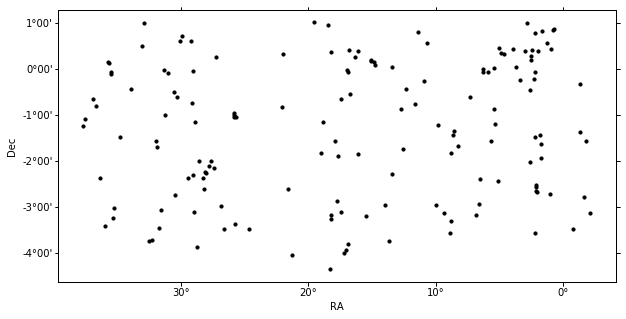

In [14]:
plt.figure(figsize=[10,5])
ax = plt.subplot(projection=imap.wcs)
plt.scatter(final_ras,final_decs, transform=ax.get_transform('fk5'), s=10, c='black', label='Peak Patch clusters to stack')
plt.xlabel("RA")
plt.ylabel("Dec")


Minimum mass: 1.078371 * 10^{14}, maximum mass: 13.014842 * 10^{14}


/opt/anaconda/3-5.3/lib/python3.7/site-packages/matplotlib/font_manager.py:1331: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


halo_masses_lambda_20to1000_zpt61topt94_2605_cls.png


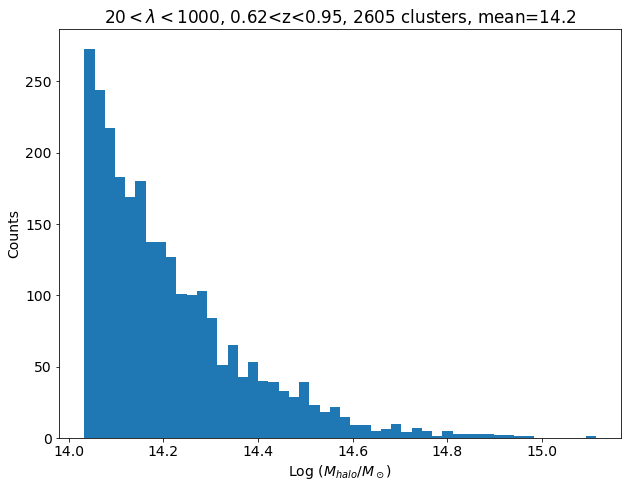

In [28]:
# Now plot masses of included clusters

font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 14}
fig = plt.figure(figsize=[9,7])

print("Minimum mass: %f * 10^{14}, maximum mass: %f * 10^{14}" %(np.amin(masses_of_stacked_cls)/10**14, np.amax(masses_of_stacked_cls)/10**14))
plt.hist(np.log10(masses_of_stacked_cls), bins=50)
plt.xlabel("Log $(M_{halo}/M_\odot)$")
plt.ylabel("Counts")

logmean=np.mean(np.log10(masses_of_stacked_cls))
plt.title("$%d<\lambda<%d$, %.2f<z<%.2f, %d clusters, mean=%.1f" %(min_richness,max_richness, zbin[0], zbin[1], Ncl_in, logmean))
plt.tight_layout()
saveas = "halo_masses_lambda_%dto%d_zpt%dtopt%d_%d_cls.png" %(min_richness,max_richness, zbin[0]*100, zbin[1]*100, Ncl_in)
plt.savefig(saveas)
print(saveas)

In [15]:
# save cluster positions for use in COOP
def DeclRatoThetaPhi(decl,RA):
    return np.radians(-decl+90.),np.radians(RA)

thetaphi = np.zeros((len(final_ras),2))
thetaphi_rand = np.zeros((len(final_ras),2))
for i in range(len(final_ras)):
    theta,phi=DeclRatoThetaPhi(final_decs[i],final_ras[i])
    thetaphi[i,0]=theta
    thetaphi[i,1]=phi
    
    #also make a randoms list
    thetaphi_rand[i,0]=theta+np.deg2rad(5*np.random.rand()) #add up to 5 degrees 
    thetaphi_rand[i,1]=phi+np.deg2rad(5*np.random.rand()) #same

    
saveas = "/mnt/scratch-lustre/mlokken/pkpatch/halos_to_stack_mass_bins/lgt%d_zpt%dtopt%d_%d_cls.txt" %(min_richness, zbin[0]*100, zbin[1]*100, Ncl_in)
np.savetxt(X=thetaphi, fname=saveas)
saveas_rand = "/mnt/scratch-lustre/mlokken/pkpatch/halos_to_stack_mass_bins/lgt%d_zpt%dtopt%d_%d_cls_randoms.txt" %(min_richness, zbin[0]*100, zbin[1]*100, Ncl_in)
np.savetxt(X=thetaphi_rand, fname=saveas_rand)
print(saveas)
print(saveas_rand)

/mnt/scratch-lustre/mlokken/pkpatch/halos_to_stack_mass_bins/lgt20_zpt52topt55_157_cls.txt
/mnt/scratch-lustre/mlokken/pkpatch/halos_to_stack_mass_bins/lgt20_zpt52topt55_157_cls_randoms.txt


FORMAT  =HEALPIX                                                                 [astropy.io.fits.card]
MAP     =/mnt/scratch-lustre/mlokken/pkpatch/pkpatch_tsz_l80_highpass_smooth_2am [astropy.io.fits.card]
FWHM_IN =2.                                                                      [astropy.io.fits.card]
PEAKS   =/home/mlokken/stacking/PeakPatch_tSZ/peaks/pkptSZ_halo_original_highz.f [astropy.io.fits.card]
FIELD   =I                                                                       [astropy.io.fits.card]
RADIUS  =0.67                                                                    [astropy.io.fits.card]
RES     =80 # .5 arcmin pixels, 2 degree radius                                  [astropy.io.fits.card]
OUTPUT  =/home/mlokken/stacking/PeakPatch_tSZ/stacks/pkptSZ_halo_original_highz_ [astropy.io.fits.card]
COLORTAB=jet                                                                     [astropy.io.fits.card]
UNIT    =degree                                                 

stacks/2605_cls_lambda_20to1000_z_pt62topt95_og.png


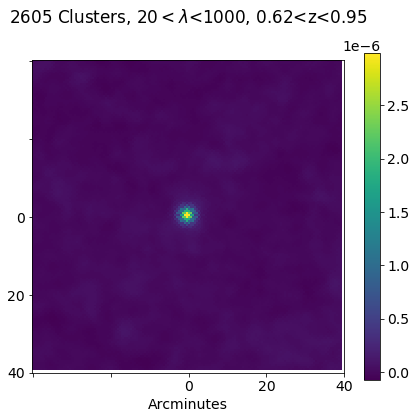

In [31]:
coop_stack = fits.open("/home/mlokken/stacking/PeakPatch_tSZ/stacks/pkptSZ_halo_original_highz_stack.fits")
cls = coop_stack[0].data
coop_stack.close()
stack = cls.byteswap(False).newbyteorder()

font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 14}

plt.rc('font', **font)
fig = plt.figure(figsize=[7,6])
plot = plt.imshow(stack)
cbar = fig.colorbar(plot)
full = len(stack[0])+1
center = full//2
locs = [0, full/4, full/2, (3/4*full), full]
labels = ['','']
for loc in locs[2:]:
    labels.append(int((loc-center)*.5))
plt.xticks(locs, labels)
plt.yticks(locs, labels)
cbar.formatter.set_powerlimits((0, 0))
cbar.update_ticks()
title = plt.title("%d Clusters, $%d<\lambda$<%d, %.2f<z<%.2f" %(Ncl_in,min_richness,max_richness, zbin[0], zbin[1]))
title.set_position((0.5, 1.1))
plt.xlabel("Arcminutes")
saveas = "stacks/%d_cls_lambda_%dto%d_z_pt%.0ftopt%.0f_og.png" %(len(thetaphi),min_richness,max_richness, zbin[0]*100, zbin[1]*100)
plt.savefig(saveas)
print(saveas)


0.5
Binning in annuli with width 1.500000 arcminutes


/opt/anaconda/3-5.3/lib/python3.7/site-packages/matplotlib/font_manager.py:1331: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


stacks/radial_prof_plus_gauss_2605_cls_lgt20_z_pt62topt95_og.png


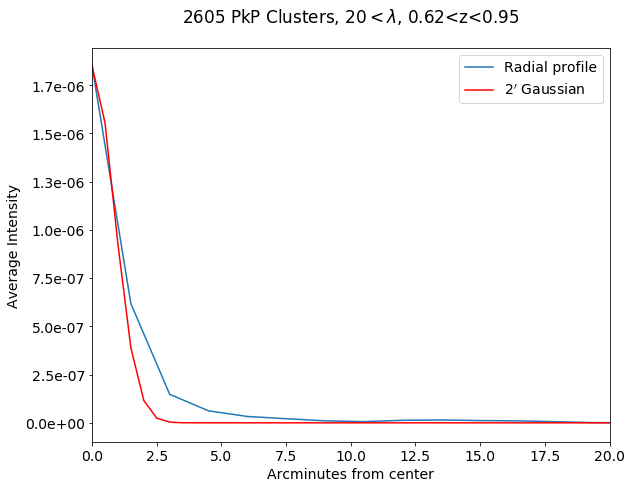

In [32]:
import matplotlib.ticker as mtick
# bin in annuli
pixel_radius = len(stack)//2
radius_in_angle = coopwidth*60 # in arcmin
arcmin_per_pixel = radius_in_angle/pixel_radius
print(arcmin_per_pixel)

pix_bin = 3
print("Binning in annuli with width %f arcminutes" %(pix_bin * arcmin_per_pixel))
no_sums = int(pixel_radius//pix_bin)
sums = []
bins_leftside = []
for i in range(0, no_sums): #moving out from the center in bin sizes of r_bin
    r_in = pix_bin * (i)
    r_out = r_in + pix_bin #outer radius of annulus
    bin_cent = (r_in+r_out)/2.
    tot = sep.sum_circann(stack, pixel_radius, pixel_radius, r_in, r_out)[0]
    ann_area = np.pi*r_out**2 - np.pi*r_in**2
    i_per_a = tot/ann_area #intensity per unit area on image
    sums.append(i_per_a)
    bins_leftside.append(r_in)
fig = plt.figure(figsize=[9,7])
ax = fig.add_subplot(111)
ax.plot(np.asarray(bins_leftside) * arcmin_per_pixel,sums,label='Radial profile')
beam_arcmin_fwhm = 2.
beam_rad_fwhm = beam_arcmin_fwhm / 60. * (np.pi/180.) # convert to radians
beam_sigma = beam_rad_fwhm/2.3548
sigma = np.rad2deg(beam_sigma)*60
amplitude = sums[0]
xaxis_pix = np.arange(len(stack[0]))-pixel_radius
xaxis_arcmin = xaxis_pix * arcmin_per_pixel
g = amplitude * np.exp(-(xaxis_arcmin)**2/(2*sigma**2))
ax.plot(xaxis_arcmin, g, 'r', label='$2\'$ Gaussian')
ax.legend()
ax.set_xlabel("Arcminutes from center")
ax.set_ylabel("Average Intensity")

ax.set_xlim(0,20)
ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1e'))
title = plt.title("%d PkP Clusters, $%d<\lambda$, %.2f<z<%.2f" %(Ncl_in,min_richness, zbin[0], zbin[1]))
title.set_position((0.5, 1.05))
plt.tight_layout()
saveas = "stacks/radial_prof_plus_gauss_%d_cls_lgt%d_z_pt%.0ftopt%.0f_og.png" %(Ncl_in, min_richness, zbin[0]*100, zbin[1]*100)
plt.savefig(saveas)
print(saveas)

In [ ]:
sigma = np.rad2deg(beam_sigma)*60
amplitude = sums[0]
g = amplitude * np.exp(-(xaxis_arcmin)**2/(2*sigma**2))
ax.plot(xaxis_arcmin, g, 'r', label='$2\'$ Gaussian')
ax.legend()
